<a href="https://colab.research.google.com/github/j0rge-20/Precip/blob/main/Mapa.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
!pip install geopandas
!pip install gpdvega
!pip install altair vega_datasets

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import descartes
import geopandas as gpd
from shapely.geometry import Point, Polygon
import altair as alt
import gpdvega

     |████████████████████████████████| 972kB 4.1MB/s 
     |████████████████████████████████| 6.5MB 39.7MB/s 
     |████████████████████████████████| 14.8MB 330kB/s 


/usr/local/lib/python3.6/dist-packages/pyproj/crs/crs.py:53: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  return _prepare_from_string(" ".join(pjargs))


    cod_est           nom_est  ...  precipitacion                         geometry
5   2120629           Venecia  ...              b   POINT (964279.920 1027425.960)
6   2119514  Univ. Fusagasuga  ...              b    POINT (967504.600 971196.190)
26  2120557      Primavera la  ...              b   POINT (985091.060 1028933.320)
36  2401519        Novilleros  ...              m  POINT (1032431.060 1081779.810)
40  2120646           Mesitas  ...              m    POINT (959880.030 998086.560)

[5 rows x 8 columns]


(899533.3636649998, 1123915.1968349998, 892588.0411200008, 1148897.33128)

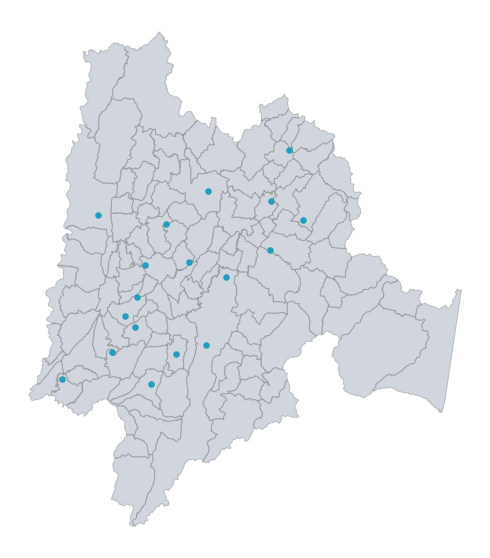

In [ ]:
#cargar shape mapa Cundinamarca
#load files
shape_file = 'Municipios_de_Cundinamarca.shp'
cundi_map = gpd.read_file(shape_file)
#cundi_map.head()

dataset_path = 'https://raw.githubusercontent.com/j0rge-20/Precip/main/dataset_estaciones.csv'
df = pd.read_csv(dataset_path)
crs = {'init':'epsg:3116'}

#dataset predicciones
path3 = "https://raw.githubusercontent.com/j0rge-20/Precip/main/consolidado_predicciones.csv"

dc = pd.read_csv(path3, parse_dates=['Fecha'],index_col="Fecha")


#print ("Valores Fuera del Mapa")
#print(df.loc[df['y'] > 1100000,['cod_est','nom_est','x','y']])

#remover puntos fuera del mapa
df1 = df.loc[df['y'] < 1100000]

#estaciones
estaciones = ['2120540','2306507','2120557','2401519','2120562','2120548','2120559','2120561','2120629','2401513','2120639','2120630','2120646','2120641','2120644','2120647','2119514','2306517','2306516'] 
#dataframe estaciones analizadas 
df2 = df1[df1['cod_est'].isin(estaciones)]
#print ('df2 ', df2.info())


geometry = [Point(xy) for xy in zip(df2["x"], df2["y"])]
geo_df = gpd.GeoDataFrame(df2, crs = crs, geometry = geometry)
print(geo_df.head())

#mapa general
#cundi_map.plot(ax = ax ,alpha = 0.4 , color = "grey" )

#mapa con estaciones
fig,ax = plt.subplots(figsize = (20,10))
cundi_map.plot(ax = ax ,alpha = 0.4 , edgecolor='gray', color = "#8d99ae" )
geo_df.plot(ax = ax , markersize = 30,color = "#219ebc")
#remove axes
plt.axis('off')

##plot condicional
# geo_df[geo_df['precipitacion']=='a'].plot(ax = ax , markersize = 30,color = "green")
# geo_df[geo_df['precipitacion']=='m'].plot(ax = ax , markersize = 30,color = "yellow")
# geo_df[geo_df['precipitacion']=='b'].plot(ax = ax , markersize = 30,color = "red")


#print(cundi_map.head())
#print(cundi_map.columns)



/usr/local/lib/python3.6/dist-packages/pyproj/crs/crs.py:53: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  return _prepare_from_string(" ".join(pjargs))


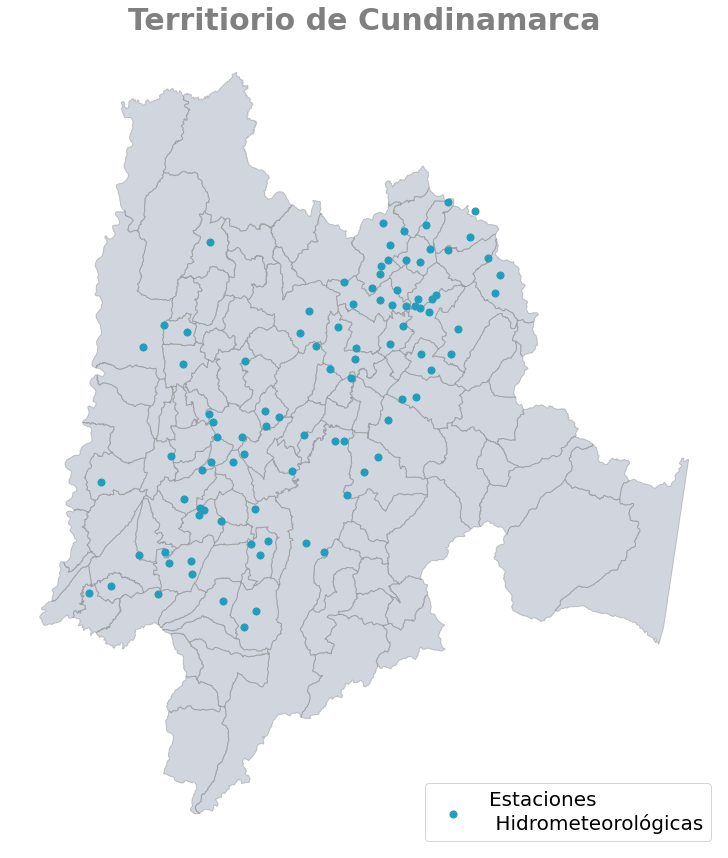

In [ ]:
#MAPA COMPLETO
#cargar shape mapa Cundinamarca
#load files
shape_file = 'Municipios_de_Cundinamarca.shp'
cundi_map = gpd.read_file(shape_file)
#cundi_map.head()

dataset_path = 'https://raw.githubusercontent.com/j0rge-20/Precip/main/dataset_estaciones.csv'
df = pd.read_csv(dataset_path)
crs = {'init':'epsg:3116'}

#dataset predicciones
path3 = "https://raw.githubusercontent.com/j0rge-20/Precip/main/consolidado_predicciones.csv"

dc = pd.read_csv(path3, parse_dates=['Fecha'],index_col="Fecha")


#print ("Valores Fuera del Mapa")
#print(df.loc[df['y'] > 1100000,['cod_est','nom_est','x','y']])

#remover puntos fuera del mapa
df1 = df.loc[df['y'] < 1100000]

#estaciones
estaciones = ['2120540','2306507','2120557','2401519','2120562','2120548','2120559','2120561','2120629','2401513','2120639','2120630','2120646','2120641','2120644','2120647','2119514','2306517','2306516'] 
#dataframe estaciones analizadas 
#df2 = df1[df1['cod_est'].isin(estaciones)]
df2 = df1.copy()
#print ('df2 ', df2.info())


geometry = [Point(xy) for xy in zip(df2["x"], df2["y"])]
geo_df = gpd.GeoDataFrame(df2, crs = crs, geometry = geometry)
#print(geo_df.head())

#mapa general
#cundi_map.plot(ax = ax ,alpha = 0.4 , color = "grey" )

#mapa con estaciones
fig,ax = plt.subplots(figsize = (25,15))
cundi_map.plot(ax = ax ,alpha = 0.4 , edgecolor='gray', color = "#8d99ae" )
geo_df.plot(ax = ax , markersize = 50,color = "#219ebc",label="Estaciones \n Hidrometeorológicas")
#remove axes
plt.axis('off')
plt.title(label='Territiorio de Cundinamarca',size = 30, color = 'gray',fontweight='bold')

plt.legend(loc='lower right',prop={'size': 20})



In [ ]:
#https://altair-viz.github.io/gallery/index.html
#https://altair-viz.github.io/gallery/airports_count.html
#https://github.com/iliatimofeev/gpdvega
#https://stackoverflow.com/questions/50433842/customize-legend-and-color-scale-in-interactive-charts-altair
#https://medium.com/swlh/interactive-choropleth-maps-in-python-dd943b99df50

#https://mpld3.github.io/examples/scatter_tooltip.html


import altair as alt
from vega_datasets import data

airports = data.airports.url
states = alt.topo_feature(data.us_10m.url, feature='states')

# US states background
background = alt.Chart(states).mark_geoshape(
    fill='lightgray',
    stroke='white'
).properties(
    width=500,
    height=300
).project('albersUsa')

# airport positions on background
points = alt.Chart(airports).transform_aggregate(
    latitude='mean(latitude)',
    longitude='mean(longitude)',
    count='count()',
    groupby=['state']
).mark_circle().encode(
    longitude='longitude:Q',
    latitude='latitude:Q',
    size=alt.Size('count:Q', title='Number of Airports'),
    color=alt.value('steelblue'),
    tooltip=['state:N','count:Q']
).properties(
    title='Number of airports in US'
)

background + points

#background

alt.LayerChart(...)

In [ ]:


world = gpd.read_file(gpd.datasets.get_path('naturalearth_lowres'))

# GeoDataFrame could be passed as usual pd.DataFrame
alt.Chart(world[world.continent!='Antarctica']).mark_geoshape(
).project(
).encode(
    color='pop_est', # shorthand infer types as for regular pd.DataFrame
    tooltip='id:Q' # GeoDataFrame.index is accessible as id
).properties(
    width=500,
    height=300
)

/usr/local/lib/python3.6/dist-packages/altair/utils/data.py:229: AltairDeprecationWarning: alt.pipe() is deprecated, and will be removed in a future release. Use toolz.curried.pipe() instead.
  AltairDeprecationWarning,
/usr/local/lib/python3.6/dist-packages/pandas/core/frame.py:1490: FutureWarning: Using short name for 'orient' is deprecated. Only the options: ('dict', list, 'series', 'split', 'records', 'index') will be used in a future version. Use one of the above to silence this warning.
  FutureWarning,


alt.Chart(...)

In [ ]:
points = alt.Chart(geo_df).mark_geoshape(
).project(
).encode(
    color= alt.value('#219ebc'),
    tooltip=['nom_est:N','precipitacion:N'] # GeoDataFrame.index is accessible as id
).properties(
    width=800,
    height=600
)

background = alt.Chart(cundi_map).mark_geoshape(
    fill='lightgray',
    stroke='white'
).properties(
    width=800,
    height=600
).properties(
    title='Precipitaciones Cundinamarca'
)

background + points


#points

/usr/local/lib/python3.6/dist-packages/altair/utils/data.py:229: AltairDeprecationWarning: alt.pipe() is deprecated, and will be removed in a future release. Use toolz.curried.pipe() instead.
  AltairDeprecationWarning,
/usr/local/lib/python3.6/dist-packages/pandas/core/frame.py:1490: FutureWarning: Using short name for 'orient' is deprecated. Only the options: ('dict', list, 'series', 'split', 'records', 'index') will be used in a future version. Use one of the above to silence this warning.
  FutureWarning,


alt.LayerChart(...)

In [ ]:
points = alt.Chart(geo_df).mark_geoshape(
).project(
).encode(
    color= alt.value('#219ebc'),
    tooltip=['nom_est:N','precipitacion:N'] # GeoDataFrame.index is accessible as id
).properties(
    width=800,
    height=600
)

background = alt.Chart(cundi_map).mark_geoshape(
    fill='lightgray',
    stroke='white'
).properties(
    width=800,
    height=600
).properties(
    title='Precipitaciones Cundinamarca'
)

background + points


alt.LayerChart(...)